In [1]:
import numpy as np
import porespy as ps
import matplotlib.pyplot as plt
import nibabel as nib
import pandas as pd
from IPython.display import clear_output
from skimage.segmentation import find_boundaries
from collections import Counter
from skimage import morphology
import time
import scipy
import mcubes
import trimesh
import ast
import pickle

In [3]:
def merge(parts, concatenate_colors=True):
    # Concateno los vertices
    vertices = np.concatenate(([p.vertices for p in parts]), axis=0)

    # En cada componente de parts, el indice de las faces empieza desde 0
    # Con offset, se calcula el indice que se debe sumar a las caras de cada parte
    # cuando ests se unan en el mismo objeto trimesh
    offset = [0]
    for i, p in enumerate(parts):
        offset.append(int(p.faces.max()+1))
    offset=np.cumsum(offset)
    
    # Concateno las caras añadiendo el offset
    faces = np.concatenate(([p.faces + offset[i] for i, p in enumerate(parts)]), axis=0)
        
    # Creo nueva mesh
    mesh2send = trimesh.Trimesh(vertices=vertices, faces=faces, process=False)

    # Concateno los colores
    if concatenate_colors:
        colors = np.concatenate(([p.visual.vertex_colors for i, p in enumerate(parts)]), axis=0)
        mesh2send.visual.vertex_colors = colors

    return mesh2send



def rgbA(value, only_one_color='rgb', minimum=0, maximum=255):
    # if minimum != -1 or maximum != -1:
    # minimum, maximum = float(min(value)), float(max(value))
    zeros = np.zeros(shape=value.shape, dtype=value.dtype)
    if only_one_color=='rgb':
        ratio = 2 * (value-minimum) / (maximum - minimum)
        
        b = np.maximum(zeros, 255*(1-ratio))
        r = np.maximum(zeros, 255*(ratio-1))
        
        b =  np.asarray(b, dtype='uint8')
        r =  np.asarray(r, dtype='uint8')
        
        g = 255 - b - r
    
        rgb0 = np.array([r,g,b,zeros+255]).transpose()
    
        return rgb0.astype('uint8')
    
    
def Median3D_Array(NumpyArray, disk_size):
    # disk_size: el tamaño de los objetos que el median filter elimina
    # objetos aislados de menor o igual tamaño se los ventila    
    x_height, y_height, z_depth = NumpyArray.shape[0], NumpyArray.shape[1], NumpyArray.shape[2]

    # Hay arrays que se guardan como una cuarta dimension de valor =1 que no se porque lo hace...
    # Con esto lo quito
    if len(NumpyArray.shape) == 4:
        NumpyArray = NumpyArray[:,:,:,0]
    
    return scipy.ndimage.median_filter(NumpyArray, size=disk_size)

    # Bluring over the {xy} plane
    for i in range(0, z_depth):
        NumpyArray[:,:,i]=skimage.filters.median(NumpyArray[:,:,i], disk(disk_size))
    # Bluring over the {xz} plane
    for i in range(0, y_height):
        NumpyArray[:,i,:]=skimage.filters.median(NumpyArray[:,i,:], disk(disk_size))
    # Bluring over the {yz} plane
    for i in range(0, x_height):
        NumpyArray[i,:,:]=skimage.filters.median(NumpyArray[i,:,:], disk(disk_size))
       
    return NumpyArray

In [3]:
e = "20190516_E3"

In [4]:
FILE = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/cell_properties.csv"
cellpose_nu = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/RESULTS/nuclei/{e}_MASK_EQ_XYZ.nii.gz"
gasp_mem = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/RESULTS/membranes/GASP_PNAS/{e}_mGFP_CardiacRegion_0.5_XYZ_predictions_GASP.nii.gz"
linefile = (f"/Users/dvarelat/Documents/MASTER/TFM/DATA/LINES/CC/line_{e}_CC.nii.gz")

In [5]:
pred_mem = nib.load(gasp_mem).get_fdata()
pred_mem.shape

(870, 651, 437)

In [6]:
img = morphology.label(pred_mem)
props = ps.metrics.regionprops_3D(img)

In [5]:
print(img.shape)
print(len(np.unique(img)))

(877, 829, 526)
11571
3


In [9]:
disk_size=3
imgi = pred_mem.astype('uint16')
imgi.shape

(870, 651, 437)

In [7]:
volumes = [p.volume for p in props]
sphericities = [p.sphericity for p in props]

In [15]:
centroids_int = [[round(i) for i in p["centroid"]] for p in props]
original_labels_centroids = [imgi[c[0],c[1],c[2]] for c in centroids_int]
# dict_labels_count = dict(Counter(original_labels_centroids))

In [24]:
#[p.axis_minor_length for p in props]
for i in range(len(props)):
    print(i, props[i].inertia_tensor_eigvals)
    print(i, props[i].axis_minor_length)
    print("----------")

0 [15.846212490557567, 12.032037863726108, 4.89471825144116]
0 3.2871623394802096
----------
1 [51.75694225771026, 44.22329710017652, 22.982316514924477]
1 12.429268424726668
----------
2 [80.45983503522696, 74.19779630038352, 46.04798543055389]
2 19.946414889826805
----------
3 [54.9967856521811, 45.99021044603789, 15.469224711127893]
3 8.039060582546124
----------
4 [341.7495891965562, 306.9556693041909, 108.58359406363131]
4 27.164254852888202
----------
5 [67.08780050786959, 60.56091428182256, 15.289271070083974]
5 9.36076110369074
----------
6 [40.69406850441296, 37.638980530090784, 28.619479156785573]
6 15.98886837223429
----------
7 [50.83184136199753, 35.313197068221434, 29.27466910852035]
7 11.728608107846494
----------
8 [110.25486611757334, 84.4583482049185, 57.28826403109275]
8 17.74591392925084
----------
9 [23.82910160568303, 18.64852054247211, 11.655944347782304]
9 8.0469642005985
----------
10 [42.64359750634831, 36.91630507430415, 26.3563440584982]
10 14.36281714234851

ValueError: math domain error

In [33]:
props[i].inertia_tensor_eigvals
from math import sqrt

-2.6645352591003757e-15

In [38]:
#ev = props[i].inertia_tensor_eigvals
#sqrt(10 * (-ev[0] + ev[1] + ev[2]))
props[2745].mask.shape
l = []
for p in props:
    try:
        l.append(p.axis_minor_length)
    except:
        l.append(0)

In [39]:
df = pd.DataFrame({"cell":range(len(props)),
                "sphericities":sphericities, 
                  "volumes": volumes, 
                  "original_labels":original_labels_centroids,
                  "axis_minor_length": l})
df.head()

,cell,sphericities,volumes,original_labels,axis_minor_length
0,0,1.145501,228,5719,3.287162
1,1,0.881619,2635,3966,12.429268
2,2,0.594569,6278,3122,19.946415
3,3,0.867855,1711,3919,8.039061
4,4,0.632029,33223,2616,27.164255


In [12]:
props[0].centroid

(0.8114035087719298, 134.140350877193, 161.03508771929825)

# FILTERING


In [30]:
df.describe()

,cell,sphericities,volumes,original_labels
count,11570.000000,11570.000000,11570.000000,11570.000000
mean,5784.500000,0.669202,4061.995160,5792.273639
std,3340.115642,0.074842,4287.707603,3344.388382
min,0.000000,0.341864,41.000000,0.000000
25%,2892.250000,0.628218,2272.250000,2897.250000
50%,5784.500000,0.666265,3237.000000,5792.500000
75%,8676.750000,0.705386,4599.750000,8687.750000
max,11569.000000,1.839117,102001.000000,11583.000000


In [41]:
df_clean = df[df.original_labels != 0]
df_clean.describe()

,cell,sphericities,volumes,original_labels,axis_minor_length
count,11741.000000,11741.000000,11741.000000,11741.000000,11741.000000
mean,5870.502172,0.657075,4388.562303,5887.458479,13.864801
std,3389.934766,0.090601,4700.324490,3398.425424,4.437658
min,0.000000,0.309154,41.000000,2.000000,0.000000
25%,2935.000000,0.606753,2268.000000,2944.000000,11.462293
50%,5870.000000,0.649852,3747.000000,5886.000000,14.020374
75%,8806.000000,0.694464,5354.000000,8828.000000,16.327297
max,11742.000000,2.374282,138370.000000,11774.000000,49.845819


### Original labels repetidos

In [18]:
df_clean[df_clean.duplicated(['original_labels'])]

,cell,sphericities,volumes,original_labels
72,72,0.564377,58,4781
1528,1528,0.564624,3007,1809
1744,1744,0.463643,41,5409
1914,1914,0.487004,3913,1564
2195,2195,0.483111,48,1179
2295,2295,0.567884,70,3646
2469,2469,0.455473,187,4073
2652,2652,0.747041,3811,10524
3565,3565,0.397303,44,6585
3606,3606,0.652236,7637,11124


In [35]:
df_clean[df_clean.original_labels == 5115]

,cell,sphericities,volumes,original_labels
254,254,0.634312,4753,5115
277,277,0.487255,15156,5115


In [42]:
df_clean = df_clean[df_clean.volumes < 1.5*np.median(df_clean.volumes)]
df_clean.describe()

,cell,sphericities,volumes,original_labels,axis_minor_length
count,9097.000000,9097.000000,9097.000000,9097.000000,9097.000000
mean,5759.132351,0.664433,2910.134220,5588.354952,12.433999
std,3450.103862,0.094645,1590.083607,3323.813708,3.448961
min,0.000000,0.309154,41.000000,2.000000,0.000000
25%,2661.000000,0.613916,1581.000000,2701.000000,10.502398
50%,5742.000000,0.655645,3171.000000,5517.000000,13.028239
75%,8754.000000,0.701610,4173.000000,8330.000000,14.874647
max,11742.000000,2.374282,5619.000000,11774.000000,20.586555


In [43]:
df_clean = df_clean[df_clean.volumes > 0.2*np.median(df_clean.volumes)]
df_clean.describe()

,cell,sphericities,volumes,original_labels,axis_minor_length
count,7865.000000,7865.000000,7865.000000,7865.000000,7865.000000
mean,5747.180547,0.665722,3321.278322,5603.724476,13.418572
std,3446.623579,0.073209,1292.792320,3303.287659,2.475852
min,1.000000,0.450051,635.000000,2.000000,4.049430
25%,2665.000000,0.619942,2464.000000,2727.000000,11.766104
50%,5748.000000,0.658697,3440.000000,5560.000000,13.543614
75%,8711.000000,0.701001,4321.000000,8325.000000,15.149392
max,11733.000000,1.443475,5619.000000,11763.000000,20.586555


In [18]:
df_clean[df_clean.duplicated(['original_labels'])]

,cell,sphericities,volumes,original_labels


In [19]:
df_clean = df_clean.drop_duplicates(subset='original_labels')
df_clean.shape

(8331, 4)

### After filtering

In [35]:
volume255 = df_clean.volumes - df_clean.volumes.min()
volume255 = 255*(volume255/volume255.max())
volumeRGB = rgbA(volume255)

In [36]:
df_clean["volumeRGB"] = [list(i) for i in volumeRGB]

In [37]:
volume255 = df_clean.sphericities - df_clean.sphericities.min()
volume255 = 255*(volume255/volume255.max())
volumeRGB_SPH = rgbA(volume255)

In [38]:
df_clean["sphericityRGB"] = [list(i) for i in volumeRGB_SPH] 
#df_clean["sphericityRGB"] = list_rgba(df_clean, "sphericities")

In [34]:
[list(i) for i in volumeRGB]

[[47, 208, 0, 255],
 [4, 251, 0, 255],
 [0, 243, 12, 255],
 [174, 81, 0, 255],
 [78, 177, 0, 255],
 [0, 185, 70, 255],
 [0, 85, 170, 255],
 [0, 112, 143, 255],
 [0, 85, 170, 255],
 [0, 35, 220, 255],
 [193, 62, 0, 255],
 [159, 96, 0, 255],
 [206, 49, 0, 255],
 [0, 132, 123, 255],
 [190, 65, 0, 255],
 [0, 197, 58, 255],
 [0, 147, 108, 255],
 [0, 174, 81, 255],
 [0, 71, 184, 255],
 [91, 164, 0, 255],
 [222, 33, 0, 255],
 [10, 245, 0, 255],
 [21, 234, 0, 255],
 [124, 131, 0, 255],
 [145, 110, 0, 255],
 [24, 231, 0, 255],
 [0, 98, 157, 255],
 [0, 77, 178, 255],
 [108, 147, 0, 255],
 [0, 212, 43, 255],
 [0, 236, 19, 255],
 [1, 254, 0, 255],
 [0, 15, 240, 255],
 [0, 85, 170, 255],
 [0, 48, 207, 255],
 [131, 124, 0, 255],
 [131, 124, 0, 255],
 [0, 33, 222, 255],
 [221, 34, 0, 255],
 [0, 7, 248, 255],
 [0, 93, 162, 255],
 [0, 206, 49, 255],
 [90, 165, 0, 255],
 [0, 55, 200, 255],
 [0, 113, 142, 255],
 [0, 132, 123, 255],
 [0, 80, 175, 255],
 [117, 138, 0, 255],
 [0, 147, 108, 255],
 [0, 117, 1

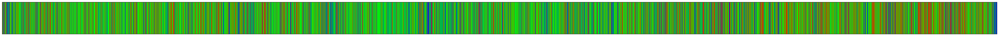

In [58]:
scaled_colours = [[color / 255 for color in row] for row in [list(i) for i in df_clean.volumeRGB]]
fig, ax = plt.subplots(figsize=(60, 2))
ax.axis(xmin=0, xmax=len(scaled_colours))
ax.tick_params(left=False, labelleft=False, bottom=False, labelbottom=False)

for index, colour in enumerate(scaled_colours):
    ax.axvspan(index, index + 1, color=colour)

## SAVE FILTERED DF

In [16]:
FILE = "/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/20190404_E1/cell_properties_clean.csv"
df_clean.to_csv(FILE, index=False, header=True)

NameError: name 'df_clean' is not defined

# MESH

In [5]:
e = "20190401_E1"
FILE_DF = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/cell_properties.csv"
df_clean = pd.read_csv(FILE_DF)

In [11]:
print(df_clean.shape)
df_clean.head()

(4811, 12)


,cell_in_props,volumes,sphericities,original_labels,centroids,lines,axis_major_length,axis_minor_length,volumeRGB,sphericityRGB,nuclei_label_cent,nuclei_cell_in_props
0,0,800,0.835634,3124.0,"[4, 429, 90]",0.0,14.654125,9.599439,"[0, 4, 251, 255]","[0, 197, 58, 255]",5762.0,1
1,3,1112,0.897111,3433.0,"[2, 441, 98]",0.0,19.793558,8.056702,"[0, 5, 250, 255]","[0, 221, 34, 255]",6311.0,2
2,4,1900,0.789857,3928.0,"[5, 477, 110]",0.0,23.271100,12.631052,"[0, 9, 246, 255]","[0, 178, 77, 255]",7536.0,3
3,5,2980,0.885549,4378.0,"[3, 500, 119]",0.0,36.885454,9.078878,"[0, 14, 241, 255]","[0, 217, 38, 255]",6864.0,18
4,6,503,1.107930,5749.0,"[1, 496, 160]",0.0,17.482689,4.583767,"[0, 3, 252, 255]","[50, 205, 0, 255]",13062.0,4


In [8]:
dict_label_cell = dict(zip(df_clean.original_labels, df_clean.cell_in_props))
dict_label_rgb_vol = dict(zip(df_clean.original_labels, df_clean.volumeRGB))
#dict_label_rgb_esp = dict(zip(df_clean.original_labels, df_clean.sphericityRGB))

In [7]:
gasp_mem = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/RESULTS/membranes/GASP_PNAS/{e}_mGFP_CardiacRegion_0.5_XYZ_predictions_GASP.nii.gz"

In [9]:
pred_mem = nib.load(gasp_mem).get_fdata()
print(pred_mem.shape)
img = morphology.label(pred_mem)
props = ps.metrics.regionprops_3D(img)

(742, 871, 507)


In [16]:
meshes = []
cell_id = 3124.0
prop = props[dict_label_cell[cell_id]]
coords = prop.mask * 1
coords.shape

(11, 16, 11)

In [58]:
from skimage.measure import regionprops
propsw = regionprops(img)

In [31]:
cell_cords = np.asarray(np.where(pred_mem==cell_id)).T
cell_cords_aux = cell_cords.copy()
cell_cords -= cell_cords.min(axis=0)
cell_cords_3d = np.zeros(shape=(cell_cords.max(axis=0) + 1), dtype='uint8')
for cord in cell_cords:
    cell_cords_3d[cord[0], cord[1], cord[2]] = 1

In [50]:
#np.all(cell_cords_3d == coords)
add = 10
assert add%2==0
aux = np.zeros(shape=tuple(np.asarray(cell_cords_3d.shape)+add), dtype='uint8')
aux[add//2:-add//2,add//2:-add//2,add//2:-add//2] = cell_cords_3d.copy()
cell_cords_3d = aux.copy()
del aux

In [55]:
cell_cords_aux.min(axis=0)

array([  0, 420,  85])

In [56]:
np.array([prop.slices[i].start for i in [0, 1, 2]])

array([  0, 420,  85])

In [29]:
for i, cell_id in enumerate(list(df_clean.original_labels)): #[::100]
    runtime = time.time()
    print(i)
    print(cell_id, '/', df_clean.shape[0])
    prop = props[dict_label_cell[cell_id]]
    coords = prop.mask * 1
    # Espacio libre alrededor del cubo que engloba la celula
    add = 10
    assert add%2==0
    aux = np.zeros(shape=tuple(np.asarray(coords.shape)+add), dtype='uint8')
    aux[add//2:-add//2,add//2:-add//2,add//2:-add//2] = coords.copy()
    coords = aux.copy()
    del aux
    coords = Median3D_Array(coords.copy(), disk_size=3)
    vert, trian = mcubes.marching_cubes(mcubes.smooth(coords), 0)
    if len(vert)>0 and len(trian)>0:
        vert -= np.asarray([add//2, add//2, add//2])
        vert += np.array([prop.slices[i].start for i in [0,1,2]])
        m_cell = trimesh.Trimesh(vert, trian, process=False)
        trimesh.smoothing.filter_taubin(m_cell, lamb=0.5, nu=-0.5, iterations=20)
        m_cell = m_cell.simplify_quadratic_decimation(int(100)) ## BAJARLE
        #m_cell2 = m_cell.copy()
        #m_cell.visual.vertex_colors = ast.literal_eval(dict_label_rgb_vol[cell_id]) 
        #m_cell2.visual.vertex_colors = dict_label_rgb_esp[cell_id]
        meshes.append(m_cell)
        #meshes2.append(m_cell2)
    else:
        print("NOOOOO")
runtime = time.time() - runtime
print(f"Meshing took {runtime:.2f} s")

0
3124.0 / 4811
1
3433.0 / 4811
2
3928.0 / 4811
3
4378.0 / 4811
4
5749.0 / 4811
5
6203.0 / 4811
6
6033.0 / 4811
7
6604.0 / 4811
8
3125.0 / 4811
9
3929.0 / 4811
10
3288.0 / 4811
11
4954.0 / 4811
12
2948.0 / 4811
13
6380.0 / 4811
14
4823.0 / 4811
15
4850.0 / 4811
16
4209.0 / 4811
17
3767.0 / 4811
18
4710.0 / 4811
19
4584.0 / 4811
20
3335.0 / 4811
21
2005.0 / 4811
22
4742.0 / 4811
23
5303.0 / 4811
24
4798.0 / 4811
25
3391.0 / 4811
26
5242.0 / 4811
27
3336.0 / 4811
28
5169.0 / 4811
29
3713.0 / 4811
30
5425.0 / 4811
31
4743.0 / 4811
32
4163.0 / 4811
33
5426.0 / 4811
34
4276.0 / 4811
35
2949.0 / 4811
36
4379.0 / 4811
37
4711.0 / 4811
38
5660.0 / 4811
39
2317.0 / 4811
40
3543.0 / 4811
41
4467.0 / 4811
42
5170.0 / 4811
43
4668.0 / 4811
44
3715.0 / 4811
45
3434.0 / 4811
46
4586.0 / 4811
47
3714.0 / 4811
48
3930.0 / 4811
49
3392.0 / 4811
50
3435.0 / 4811
51
2674.0 / 4811
52
4773.0 / 4811
53
6473.0 / 4811
54
5605.0 / 4811
55
2525.0 / 4811
56
4468.0 / 4811
57
5122.0 / 4811
58
4503.0 / 4811
59
5267

463
2269.0 / 4811
464
3073.0 / 4811
465
4333.0 / 4811
466
1953.0 / 4811
467
3881.0 / 4811
468
3011.0 / 4811
469
4021.0 / 4811
470
3446.0 / 4811
471
4389.0 / 4811
472
851.0 / 4811
473
1270.0 / 4811
474
853.0 / 4811
475
3825.0 / 4811
476
1779.0 / 4811
477
4426.0 / 4811
478
5634.0 / 4811
479
5729.0 / 4811
480
1952.0 / 4811
481
3721.0 / 4811
482
6205.0 / 4811
483
3397.0 / 4811
484
3185.0 / 4811
485
1394.0 / 4811
486
5203.0 / 4811
487
723.0 / 4811
488
6515.0 / 4811
489
5463.0 / 4811
490
3077.0 / 4811
491
721.0 / 4811
492
679.0 / 4811
493
2478.0 / 4811
494
4747.0 / 4811
495
1203.0 / 4811
496
2958.0 / 4811
497
2059.0 / 4811
498
2007.0 / 4811
499
6685.0 / 4811
500
6034.0 / 4811
501
5334.0 / 4811
502
6566.0 / 4811
503
5272.0 / 4811
504
3550.0 / 4811
505
1698.0 / 4811
506
638.0 / 4811
507
3941.0 / 4811
508
4170.0 / 4811
509
3139.0 / 4811
510
2959.0 / 4811
511
6560.0 / 4811
512
3655.0 / 4811
513
4020.0 / 4811
514
3552.0 / 4811
515
568.0 / 4811
516
2410.0 / 4811
517
2412.0 / 4811
518
4777.0 / 4811

924
3296.0 / 4811
925
477.0 / 4811
926
2228.0 / 4811
927
3837.0 / 4811
928
2275.0 / 4811
929
2728.0 / 4811
930
401.0 / 4811
931
5402.0 / 4811
932
540.0 / 4811
933
905.0 / 4811
934
2018.0 / 4811
935
3884.0 / 4811
936
4223.0 / 4811
937
3503.0 / 4811
938
2326.0 / 4811
939
983.0 / 4811
940
2686.0 / 4811
941
4510.0 / 4811
942
2685.0 / 4811
943
236.0 / 4811
944
861.0 / 4811
945
3776.0 / 4811
946
726.0 / 4811
947
5057.0 / 4811
948
343.0 / 4811
949
372.0 / 4811
950
944.0 / 4811
951
946.0 / 4811
952
2904.0 / 4811
953
2121.0 / 4811
954
2274.0 / 4811
955
2906.0 / 4811
956
475.0 / 4811
957
2417.0 / 4811
958
1651.0 / 4811
959
215.0 / 4811
960
683.0 / 4811
961
311.0 / 4811
962
403.0 / 4811
963
1501.0 / 4811
964
1213.0 / 4811
965
2017.0 / 4811
966
3947.0 / 4811
967
1604.0 / 4811
968
2838.0 / 4811
969
3728.0 / 4811
970
1111.0 / 4811
971
6392.0 / 4811
972
2176.0 / 4811
973
6009.0 / 4811
974
767.0 / 4811
975
474.0 / 4811
976
3946.0 / 4811
977
478.0 / 4811
978
765.0 / 4811
979
1603.0 / 4811
980
2634.0 / 

1367
864.0 / 4811
1368
2911.0 / 4811
1369
3780.0 / 4811
1370
731.0 / 4811
1371
1706.0 / 4811
1372
6692.0 / 4811
1373
6367.0 / 4811
1374
6476.0 / 4811
1375
685.0 / 4811
1376
4234.0 / 4811
1377
1408.0 / 4811
1378
4754.0 / 4811
1379
1115.0 / 4811
1380
5058.0 / 4811
1381
4342.0 / 4811
1382
2845.0 / 4811
1383
1034.0 / 4811
1384
2689.0 / 4811
1385
4439.0 / 4811
1386
4091.0 / 4811
1387
5837.0 / 4811
1388
4720.0 / 4811
1389
6010.0 / 4811
1390
146.0 / 4811
1391
5640.0 / 4811
1392
2779.0 / 4811
1393
1223.0 / 4811
1394
6577.0 / 4811
1395
482.0 / 4811
1396
2637.0 / 4811
1397
2231.0 / 4811
1398
4911.0 / 4811
1399
866.0 / 4811
1400
911.0 / 4811
1401
1333.0 / 4811
1402
545.0 / 4811
1403
1790.0 / 4811
1404
6405.0 / 4811
1405
3357.0 / 4811
1406
483.0 / 4811
1407
144.0 / 4811
1408
5428.0 / 4811
1409
2912.0 / 4811
1410
865.0 / 4811
1411
6543.0 / 4811
1412
446.0 / 4811
1413
1116.0 / 4811
1414
380.0 / 4811
1415
3781.0 / 4811
1416
1561.0 / 4811
1417
4294.0 / 4811
1418
6011.0 / 4811
1419
5059.0 / 4811
1420
5

1805
5665.0 / 4811
1806
5923.0 / 4811
1807
3460.0 / 4811
1808
1122.0 / 4811
1809
4141.0 / 4811
1810
6289.0 / 4811
1811
5546.0 / 4811
1812
4721.0 / 4811
1813
417.0 / 4811
1814
4446.0 / 4811
1815
4807.0 / 4811
1816
697.0 / 4811
1817
1844.0 / 4811
1818
2916.0 / 4811
1819
6492.0 / 4811
1820
5339.0 / 4811
1821
5612.0 / 4811
1822
1746.0 / 4811
1823
1972.0 / 4811
1824
4856.0 / 4811
1825
2848.0 / 4811
1826
4984.0 / 4811
1827
699.0 / 4811
1828
2591.0 / 4811
1829
4037.0 / 4811
1830
2128.0 / 4811
1831
5518.0 / 4811
1832
5016.0 / 4811
1833
3565.0 / 4811
1834
320.0 / 4811
1835
192.0 / 4811
1836
72.0 / 4811
1837
1909.0 / 4811
1838
5213.0 / 4811
1839
4180.0 / 4811
1840
5841.0 / 4811
1841
1910.0 / 4811
1842
4242.0 / 4811
1843
4960.0 / 4811
1844
2489.0 / 4811
1845
451.0 / 4811
1846
1166.0 / 4811
1847
3954.0 / 4811
1848
6518.0 / 4811
1849
6305.0 / 4811
1850
5936.0 / 4811
1851
872.0 / 4811
1852
5279.0 / 4811
1853
81.0 / 4811
1854
4346.0 / 4811
1855
171.0 / 4811
1856
1566.0 / 4811
1857
2740.0 / 4811
1858


2241
2923.0 / 4811
2242
2189.0 / 4811
2243
2858.0 / 4811
2244
1805.0 / 4811
2245
6037.0 / 4811
2246
5149.0 / 4811
2247
5102.0 / 4811
2248
5216.0 / 4811
2249
5101.0 / 4811
2250
4833.0 / 4811
2251
1419.0 / 4811
2252
1524.0 / 4811
2253
4687.0 / 4811
2254
1347.0 / 4811
2255
6169.0 / 4811
2256
1348.0 / 4811
2257
961.0 / 4811
2258
6549.0 / 4811
2259
4479.0 / 4811
2260
1525.0 / 4811
2261
1234.0 / 4811
2262
5251.0 / 4811
2263
4638.0 / 4811
2264
1669.0 / 4811
2265
2190.0 / 4811
2266
3516.0 / 4811
2267
1616.0 / 4811
2268
5773.0 / 4811
2269
4784.0 / 4811
2270
6038.0 / 4811
2271
4245.0 / 4811
2272
5794.0 / 4811
2273
387.0 / 4811
2274
5180.0 / 4811
2275
5018.0 / 4811
2276
1479.0 / 4811
2277
1001.0 / 4811
2278
4146.0 / 4811
2279
1175.0 / 4811
2280
4184.0 / 4811
2281
4246.0 / 4811
2282
2435.0 / 4811
2283
5435.0 / 4811
2284
528.0 / 4811
2285
5103.0 / 4811
2286
195.0 / 4811
2287
6329.0 / 4811
2288
1002.0 / 4811
2289
5063.0 / 4811
2290
491.0 / 4811
2291
196.0 / 4811
2292
2549.0 / 4811
2293
3903.0 / 4811

2679
124.0 / 4811
2680
1425.0 / 4811
2681
5496.0 / 4811
2682
2698.0 / 4811
2683
4187.0 / 4811
2684
106.0 / 4811
2685
6114.0 / 4811
2686
2497.0 / 4811
2687
1753.0 / 4811
2688
4250.0 / 4811
2689
5575.0 / 4811
2690
426.0 / 4811
2691
6660.0 / 4811
2692
6634.0 / 4811
2693
4962.0 / 4811
2694
3043.0 / 4811
2695
5220.0 / 4811
2696
711.0 / 4811
2697
1130.0 / 4811
2698
1131.0 / 4811
2699
5954.0 / 4811
2700
2336.0 / 4811
2701
3367.0 / 4811
2702
137.0 / 4811
2703
3966.0 / 4811
2704
561.0 / 4811
2705
5886.0 / 4811
2706
274.0 / 4811
2707
6101.0 / 4811
2708
275.0 / 4811
2709
1577.0 / 4811
2710
1674.0 / 4811
2711
4190.0 / 4811
2712
4690.0 / 4811
2713
1047.0 / 4811
2714
3471.0 / 4811
2715
203.0 / 4811
2716
877.0 / 4811
2717
2980.0 / 4811
2718
177.0 / 4811
2719
1578.0 / 4811
2720
4810.0 / 4811
2721
4641.0 / 4811
2722
359.0 / 4811
2723
623.0 / 4811
2724
3410.0 / 4811
2725
3967.0 / 4811
2726
4872.0 / 4811
2727
5043.0 / 4811
2728
2294.0 / 4811
2729
1486.0 / 4811
2730
327.0 / 4811
2731
830.0 / 4811
2732
361

3116
2556.0 / 4811
3117
465.0 / 4811
3118
1926.0 / 4811
3119
4404.0 / 4811
3120
1581.0 / 4811
3121
6219.0 / 4811
3122
4253.0 / 4811
3123
714.0 / 4811
3124
1364.0 / 4811
3125
744.0 / 4811
3126
1245.0 / 4811
3127
6254.0 / 4811
3128
671.0 / 4811
3129
592.0 / 4811
3130
2801.0 / 4811
3131
5108.0 / 4811
3132
792.0 / 4811
3133
1365.0 / 4811
3134
1305.0 / 4811
3135
66.0 / 4811
3136
3214.0 / 4811
3137
2197.0 / 4811
3138
3853.0 / 4811
3139
1867.0 / 4811
3140
5066.0 / 4811
3141
564.0 / 4811
3142
6175.0 / 4811
3143
745.0 / 4811
3144
5372.0 / 4811
3145
1184.0 / 4811
3146
4050.0 / 4811
3147
626.0 / 4811
3148
1246.0 / 4811
3149
5821.0 / 4811
3150
794.0 / 4811
3151
5067.0 / 4811
3152
6022.0 / 4811
3153
6090.0 / 4811
3154
3576.0 / 4811
3155
5186.0 / 4811
3156
6559.0 / 4811
3157
4991.0 / 4811
3158
36.0 / 4811
3159
4051.0 / 4811
3160
1247.0 / 4811
3161
887.0 / 4811
3162
5737.0 / 4811
3163
6276.0 / 4811
3164
2927.0 / 4811
3165
2140.0 / 4811
3166
2085.0 / 4811
3167
2864.0 / 4811
3168
6581.0 / 4811
3169
543

3552
2147.0 / 4811
3553
3797.0 / 4811
3554
4456.0 / 4811
3555
4614.0 / 4811
3556
4155.0 / 4811
3557
753.0 / 4811
3558
3980.0 / 4811
3559
2341.0 / 4811
3560
5128.0 / 4811
3561
2504.0 / 4811
3562
2660.0 / 4811
3563
3218.0 / 4811
3564
4156.0 / 4811
3565
3979.0 / 4811
3566
2096.0 / 4811
3567
6041.0 / 4811
3568
4648.0 / 4811
3569
6510.0 / 4811
3570
5625.0 / 4811
3571
4409.0 / 4811
3572
3978.0 / 4811
3573
2204.0 / 4811
3574
467.0 / 4811
3575
1818.0 / 4811
3576
5582.0 / 4811
3577
1990.0 / 4811
3578
2811.0 / 4811
3579
6375.0 / 4811
3580
4615.0 / 4811
3581
2870.0 / 4811
3582
4941.0 / 4811
3583
3690.0 / 4811
3584
1876.0 / 4811
3585
3475.0 / 4811
3586
3749.0 / 4811
3587
5347.0 / 4811
3588
2560.0 / 4811
3589
2342.0 / 4811
3590
5157.0 / 4811
3591
142.0 / 4811
3592
4258.0 / 4811
3593
2203.0 / 4811
3594
1591.0 / 4811
3595
5384.0 / 4811
3596
3748.0 / 4811
3597
6417.0 / 4811
3598
6223.0 / 4811
3599
3691.0 / 4811
3600
4616.0 / 4811
3601
3583.0 / 4811
3602
3099.0 / 4811
3603
893.0 / 4811
3604
6071.0 / 48

3985
1018.0 / 4811
3986
5717.0 / 4811
3987
5529.0 / 4811
3988
3696.0 / 4811
3989
3169.0 / 4811
3990
2564.0 / 4811
3991
4574.0 / 4811
3992
3426.0 / 4811
3993
1939.0 / 4811
3994
6650.0 / 4811
3995
1823.0 / 4811
3996
6714.0 / 4811
3997
5027.0 / 4811
3998
6626.0 / 4811
3999
4264.0 / 4811
4000
3592.0 / 4811
4001
1882.0 / 4811
4002
2258.0 / 4811
4003
4530.0 / 4811
4004
4618.0 / 4811
4005
4702.0 / 4811
4006
4579.0 / 4811
4007
3056.0 / 4811
4008
6512.0 / 4811
4009
2462.0 / 4811
4010
4417.0 / 4811
4011
2991.0 / 4811
4012
898.0 / 4811
4013
2463.0 / 4811
4014
3754.0 / 4811
4015
3531.0 / 4811
4016
2757.0 / 4811
4017
4918.0 / 4811
4018
2257.0 / 4811
4019
1766.0 / 4811
4020
6237.0 / 4811
4021
1194.0 / 4811
4022
2393.0 / 4811
4023
5351.0 / 4811
4024
3483.0 / 4811
4025
2353.0 / 4811
4026
4489.0 / 4811
4027
3919.0 / 4811
4028
1883.0 / 4811
4029
6471.0 / 4811
4030
4701.0 / 4811
4031
6158.0 / 4811
4032
4577.0 / 4811
4033
1998.0 / 4811
4034
2461.0 / 4811
4035
3378.0 / 4811
4036
6612.0 / 4811
4037
1997.0 /

4417
3232.0 / 4811
4418
1889.0 / 4811
4419
5893.0 / 4811
4420
6042.0 / 4811
4421
4581.0 / 4811
4422
3814.0 / 4811
4423
3538.0 / 4811
4424
5292.0 / 4811
4425
5781.0 / 4811
4426
2003.0 / 4811
4427
3178.0 / 4811
4428
6043.0 / 4811
4429
4794.0 / 4811
4430
6029.0 / 4811
4431
4795.0 / 4811
4432
4882.0 / 4811
4433
4796.0 / 4811
4434
4769.0 / 4811
4435
5854.0 / 4811
4436
5162.0 / 4811
4437
2261.0 / 4811
4438
2523.0 / 4811
4439
2720.0 / 4811
4440
2943.0 / 4811
4441
4321.0 / 4811
4442
6076.0 / 4811
4443
2524.0 / 4811
4444
2004.0 / 4811
4445
5592.0 / 4811
4446
5416.0 / 4811
4447
4863.0 / 4811
4448
3284.0 / 4811
4449
6030.0 / 4811
4450
4496.0 / 4811
4451
4862.0 / 4811
4452
5134.0 / 4811
4453
2470.0 / 4811
4454
2624.0 / 4811
4455
4658.0 / 4811
4456
3234.0 / 4811
4457
4269.0 / 4811
4458
5503.0 / 4811
4459
4205.0 / 4811
4460
3122.0 / 4811
4461
6123.0 / 4811
4462
2673.0 / 4811
4463
3332.0 / 4811
4464
2826.0 / 4811
4465
3285.0 / 4811
4466
3874.0 / 4811
4467
2763.0 / 4811
4468
5080.0 / 4811
4469
3429.0 

In [102]:
type(meshes)
len(meshes)

4811

In [101]:
meshes[0]
250171/52

4810.9807692307695

In [32]:
all_meshes = merge(meshes)

In [33]:
trimesh.util.concatenate(all_meshes)

<trimesh.Trimesh(vertices.shape=(250171, 3), faces.shape=(481100, 3))>

In [46]:
#[p.__dir__() for p in meshes]
for a in meshes[0].__dir__():
    if not a.startswith("_"):
        print(a)
    #meshes[0][a]

ray
permutate
nearest
metadata
face_attributes
vertex_attributes
process
md5
crc
faces
faces_sparse
face_normals
vertices
vertex_normals
vertex_faces
bounds
extents
scale
centroid
center_mass
density
volume
mass
moment_inertia
principal_inertia_components
principal_inertia_vectors
principal_inertia_transform
symmetry
symmetry_axis
symmetry_section
triangles
triangles_tree
triangles_center
triangles_cross
edges
edges_face
edges_unique
edges_unique_length
edges_unique_inverse
edges_sorted
edges_sorted_tree
edges_sparse
body_count
faces_unique_edges
euler_number
referenced_vertices
units
convert_units
merge_vertices
update_vertices
update_faces
remove_infinite_values
remove_duplicate_faces
rezero
split
face_adjacency
face_adjacency_edges
face_adjacency_edges_tree
face_adjacency_angles
face_adjacency_projections
face_adjacency_convex
face_adjacency_unshared
face_adjacency_radius
face_adjacency_span
integral_mean_curvature
vertex_adjacency_graph
vertex_neighbors
is_winding_consistent
is_wat

In [83]:
vertices = np.concatenate(([p.vertices for p in meshes]), axis=0)
vertices.shape

(250171, 3)

In [134]:
meshes[0].metadata = {"id": 2}

In [148]:
with open('test.pkl', 'wb') as f:
    pickle.dump(meshes, f)

## LEER PICKLE

In [4]:
def feature_colorRGB(df, variable):
    variable255 = df[variable] - df[variable].min()
    variable255 = 255 * (variable255 / variable255.max())
    variableRGB = rgbA(variable255)
    return [list(i) for i in variableRGB]

In [10]:
e = "20190401_E1"
FILE = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/20190401_E1.pkl"
FILEDF = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/cell_properties.csv"

In [6]:
with open(FILE, 'rb') as f:
    readMESHES = pickle.load(f)

In [7]:
len(readMESHES)

4811

In [11]:
df_clean = pd.read_csv(FILEDF)
df_clean.shape

(4811, 15)

In [17]:
df_clean.head(2)

,cell_in_props,volumes,sphericities,original_labels,centroids,lines,axis_major_length,axis_minor_length,volumeRGB,sphericityRGB,nuclei_label_cent,nuclei_cell_in_props,eigenvalues,eigenvectors,eccentricity3d
0,0,800,0.835634,3124.0,"[4, 429, 90]",0.0,14.654125,9.599439,"[0, 4, 251, 255]","[0, 197, 58, 255]",5762.0,1,"[18.328, 15.345, 12.198]","[[0.66, -0.313, 0.683], [-0.092, 0.869, 0.487]...",0.403
1,3,1112,0.897111,3433.0,"[2, 441, 98]",0.0,19.793558,8.056702,"[0, 5, 250, 255]","[0, 221, 34, 255]",6311.0,2,"[30.872, 22.835, 14.529]","[[0.973, -0.17, 0.159], [-0.219, -0.431, 0.875...",0.510


In [24]:
variable =  "eccentricity3d"
featRGB = feature_colorRGB(df_clean,variable)
dict_label_rgb = dict(zip(df_clean.original_labels, featRGB))

In [25]:
for i, cell_id in enumerate(list(df_clean.original_labels)):  
    readMESHES[i].visual.vertex_colors = dict_label_rgb[cell_id]

In [26]:
all_readMESHES = merge(readMESHES)
all_readMESHES 

<trimesh.Trimesh(vertices.shape=(250171, 3), faces.shape=(481100, 3))>

In [27]:
all_readMESHES.export(f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/{e}_eccentricity3d.ply")

b'ply\nformat binary_little_endian 1.0\ncomment https://github.com/mikedh/trimesh\nelement vertex 250171\nproperty float x\nproperty float y\nproperty float z\nproperty uchar red\nproperty uchar green\nproperty uchar blue\nproperty uchar alpha\nelement face 481100\nproperty list uchar int vertex_indices\nend_header\n\x9d\x86\x03A\xaf\xe0\xd5CH\xe6\xb6B7\xc8\x00\xffgF\xc3?\xf3\xdc\xd5C\xd0\xa2\xbcB7\xc8\x00\xff\xa9\x9a\tA\xaeW\xd5Cr`\xaeB7\xc8\x00\xff\x05%\xe0?Hy\xd4C\x88\xcf\xb4B7\xc8\x00\xff\xca\xa1p@0!\xd6C<H\xbdB7\xc8\x00\xff\xe2\xdf\xb3@\xec+\xd5C\xd0&\xbaB7\xc8\x00\xff\xc6\x9e\x06A\xff\x15\xd7C\x00\x90\xb6B7\xc8\x00\xff\xbdky@-\xb1\xd8C\xafx\xb8B7\xc8\x00\xff\xf48\x1cA\xbe \xd7C\x03\xde\xb0B7\xc8\x00\xff\x8f\x04\xd9@7#\xd6C\xb0.\xaaB7\xc8\x00\xff\x95kH@PR\xd7CHb\xbdB7\xc8\x00\xff\xe1>\x9c@:\xe4\xd8C\xea{\xb3B7\xc8\x00\xffK[\xe1@\xd1\xf9\xd7C\x98\xca\xb7B7\xc8\x00\xff\x99\x87\x89@\xf5\x80\xd4C\x9fo\xb0B7\xc8\x00\xff\x8b\xc4\x8a@\x164\xd8C\x06\xfa\xadB7\xc8\x00\xff"\xc9\xcd@y\xcd\xd

(250171, 4)

4810

4810

5825096.688575705

5825096.688575695

# LEER OBJETOS

In [10]:
especimens = [
        "20190504_E1",
        "20190404_E2",
        "20190520_E4",
        "20190516_E3",
        "20190806_E3",
        "20190520_E2",
        "20190401_E3",
        "20190517_E1",
        "20190520_E1",
        "20190401_E1",
    ]
ESPECIMEN = especimens[0]

### verificar tamaños

In [176]:
for e in especimens:
    print(e)
    file_obj = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/{e}.pkl"
    with open(file_obj, 'rb') as f:
        readMESHES = pickle.load(f)
    print(len(readMESHES))
    FILE_DF = f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/cell_properties.csv"
    df = pd.read_csv(FILE_DF)
    print(df.shape)
    print("---------")

20190504_E1
2637
(2637, 12)
---------
20190404_E2


FileNotFoundError: [Errno 2] No such file or directory: '/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/20190404_E2/20190404_E2.pkl'

## ADD COLOR

In [ ]:
e = "20190504_E1"
volumeRGB = feature_colorRGB(df, "volumes")
dict_label_rgb_vol = dict(zip(df.original_labels, volumeRGB))
for i, cell_id in enumerate(list(df.original_labels)):  
    readMESHES[i].visual.vertex_colors = dict_label_rgb_vol[cell_id]
all_readMESHES = merge(readMESHES)
all_readMESHES.export(f"/Users/dvarelat/Documents/MASTER/TFM/DATA/EXTRACTION/{e}/{e}_volumes.ply")

In [174]:
df

,cell_in_props,volumes,sphericities,original_labels,centroids,lines,axis_major_length,axis_minor_length,volumeRGB,sphericityRGB,nuclei_label_cent,nuclei_cell_in_props
0,0,800,0.835634,3124.0,"[4, 429, 90]",0.0,14.654125,9.599439,"[0, 4, 251, 255]","[0, 197, 58, 255]",5762.0,1
1,3,1112,0.897111,3433.0,"[2, 441, 98]",0.0,19.793558,8.056702,"[0, 5, 250, 255]","[0, 221, 34, 255]",6311.0,2
2,4,1900,0.789857,3928.0,"[5, 477, 110]",0.0,23.271100,12.631052,"[0, 9, 246, 255]","[0, 178, 77, 255]",7536.0,3
3,5,2980,0.885549,4378.0,"[3, 500, 119]",0.0,36.885454,9.078878,"[0, 14, 241, 255]","[0, 217, 38, 255]",6864.0,18
4,6,503,1.107930,5749.0,"[1, 496, 160]",0.0,17.482689,4.583767,"[0, 3, 252, 255]","[50, 205, 0, 255]",13062.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...
4806,6696,599,0.891669,5630.0,"[739, 549, 152]",0.0,16.448950,6.752954,"[0, 3, 252, 255]","[0, 219, 36, 255]",11690.0,10724
4807,6697,1243,0.841771,6593.0,"[739, 523, 229]",0.0,24.468180,6.037067,"[0, 6, 249, 255]","[0, 199, 56, 255]",18227.0,10712
4808,6698,488,0.901098,5013.0,"[739, 371, 132]",0.0,16.195753,5.527571,"[0, 2, 253, 255]","[0, 223, 32, 255]",10017.0,10726
4809,6700,1224,0.778510,6310.0,"[740, 499, 194]",0.0,27.196000,4.985949,"[0, 6, 249, 255]","[0, 174, 81, 255]",15993.0,10718


In [172]:
#mesh_list = list(trimesh.load_mesh(file_out, process=False).split())